# 8e. MEZXRF GeCMOS TMA by IMC analysis
## 1. Summary
This notebook quantifies channel features and generates the figures associated with the IMC breast cancer microarray scans comprising Supplementary Figure 1 in the MEZ-XRF paper.

In [1]:
import sys
sys.path.insert(0, '..\\code\\')

import pathlib
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt

import hph_adata_analysis as hph_adata
import scanpy as sc
import anndata as ad

import seaborn as sns

from shutil import copyfile
from imctools.io.mcd.mcdparser import McdParser
from imctools.io.txt.txtparser import TxtParser

from matplotlib_scalebar.scalebar import ScaleBar


from mpl_toolkits.axes_grid1 import ImageGrid
from matplotlib.pyplot import rc_context

from pymca_repack import unpack_pymca_h5, XrfImageMaskHDF

from skimage import filters
from skimage.transform import rescale, resize, downscale_local_mean

import high_plex_hdf as hph
import utilities

In [2]:
# Set data directory to work from 
base_dir = "C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF"
base_dir = pathlib.Path(base_dir)

# Specify the input directory where hdf files to process are located
input_dir = base_dir / 'data' / 'raw' / 'imc' / '20221215_TsH_ESRF2021Nov_tissueMA'

# Gather mcd ROIs for repackaging
imc_filepaths = list(input_dir.glob('*.txt'))
imc_filepaths = [imc_filepath for imc_filepath in imc_filepaths if 'st' not in imc_filepath.stem]


# Make output directory for unpacked IMC files
out_dir = base_dir / 'data' / 'analysis' / 'imc' / '8e_imc_TMA'
out_dir.mkdir(parents=True, exist_ok=True)
print('IMC epithelial cell pellet analysis will be output to: \n\t', out_dir) 

# Import csv of manually determined overlap coordinates between XRF and IMC
df_xrf_imc_overlap = pd.read_csv(base_dir / 'data' / 'raw' / 'imc_xrf_overlap_coords.csv')

# Import periodic table csv
df_periodic_table = pd.read_csv(base_dir / 'data' / 'raw' / 'xrf' / 'Periodic Table of Elements.csv')

imc_filepaths

IMC epithelial cell pellet analysis will be output to: 
	 C:\Users\MerrickS\OneDrive\Work\2_UZH\Papers\1_MEZ_XRF\data\analysis\imc\8e_imc_TMA


[WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/raw/imc/20221215_TsH_ESRF2021Nov_tissueMA/20221215_TsH_ESRF2021Nov_tissueMA_bl-tt_HER2_2_1.txt'),
 WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/raw/imc/20221215_TsH_ESRF2021Nov_tissueMA/20221215_TsH_ESRF2021Nov_tissueMA_bl-tt_LuminalBHER2_4_3.txt'),
 WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/raw/imc/20221215_TsH_ESRF2021Nov_tissueMA/20221215_TsH_ESRF2021Nov_tissueMA_bl-tt_LuminalB_2_2.txt')]

In [3]:
 # Collect experiment antibody panel for additional channel information
panel_path = base_dir / 'data' / 'raw' / 'antibody_panels' / 'saber_breast_cancer_balance_panel.csv'
df_panel = pd.read_csv(panel_path)
df_panel

,ab_tag,tag_isotope,xrf_emission,target,saber_rounds,shortname,ab_clone,stock_conc_ug_per_ml,use_conc_ug_per_mL,nuclear_segment,cell_segment
0,Rh103,103,Rh_Ka,DNA,NaN,DNA,Rh,NaN,NaN,1.0,NaN
1,La139,139,La_Ka,Progesterone Receptor,2.0,PR (SABER x2),SP2,NaN,NaN,NaN,NaN
2,Ce140,140,Ce_Ka,Estrogen receptor,2.0,ER (SABER x2),SP1,NaN,NaN,NaN,NaN
3,Pr141,141,Pr_Ka,Ki-67,2.0,Ki-67 (SABER x2),B56,NaN,NaN,NaN,NaN
4,Nd148,148,Nd_Ka,phospho histone h3,2.0,pHH3 (SABER x2),D8F12,NaN,NaN,NaN,NaN
5,Sm152,152,Sm_Ka,CD3,2.0,CD3 (SABER x2),NaN,NaN,NaN,NaN,NaN
6,Eu153,153,Eu_Ka,CTLA4,2.0,CTLA4 (SABER x2),NaN,NaN,NaN,NaN,NaN
7,Gd156,156,Gd_Ka,PD1,2.0,PD1 (SABER x2),NaN,NaN,NaN,NaN,NaN
8,Tb159,159,Tb_Ka,CD4,2.0,CD4 (SABER x2),EP1601Y,NaN,NaN,NaN,NaN
9,Dy161,161,Dy_Ka,Cytokeratin 7,2.0,CK7 (SABER x2),RCK105,NaN,NaN,NaN,1.0


In [4]:
def imc_txt_to_hph(imc_filepath, sample_name_ref, out_dir=None):
    acquisition_info = [
        'mcd_filepath',   
        'mcd_filename',   
        'acq_id',
        'acq_id_description',
        'step_um',
        'x_dim', 
        'y_dim',
    ]

    df_standard_measurements = pd.DataFrame(columns=acquisition_info)
    roi_dict = dict.fromkeys(acquisition_info)

    with TxtParser(imc_filepath) as parser:
        # Get acquisition
        acq_data = parser.get_acquisition_data()

        ## Collect key metadata for hdf packing
        roi_dict['mcd_filepath'] = str(imc_filepath)
        roi_dict['mcd_filename'] = str(imc_filepath.name)

        roi_dict['acq_id'] = acq_data.acquisition.id 
        roi_dict['acq_id_description'] = acq_data.acquisition.description

    #     assert(acq_data.acquisition.ablation_distance_between_shots_x == acq_data.acquisition.ablation_distance_between_shots_y)
        roi_dict['step_um'] = 0.5 # this may be accessible in mcd route, but not txt route, so defaults to 0.5
        roi_dict['x_dim'] = acq_data.acquisition.max_x
        roi_dict['y_dim'] = acq_data.acquisition.max_y

        ## Collect key channel information
        df_channels = pd.DataFrame(
            {
                'channel_labels':acq_data.channel_labels,
                'channel_masses':acq_data.channel_masses,
                'channel_names':acq_data.channel_names,
            }
        )

        ## Add panel information to channel information
        # Convert for panel merge
        df_channels['channel_masses'] = (pd.to_numeric(df_channels['channel_masses']))  

        # Panel merge
        df_channel_metadata = pd.merge(
            df_channels, 
            df_panel, 
            left_on='channel_masses', 
            right_on='tag_isotope', 
            how='left'
        ) 

        # Log channels loaded with a marker
        df_channel_metadata['loaded_channel'] = df_channel_metadata['channel_masses'].isin(df_panel['tag_isotope'])

        # Make longname for IMC samples
        df_channel_metadata['shortname'] = df_channel_metadata['shortname'].astype(str)
        df_channel_metadata['longname_imc'] = (
            df_channel_metadata[['channel_names', 'shortname']].agg(' | '.join, axis=1)
            )  
        
        # Add plot channel name
        df_channel_metadata['plot_channel'] = df_channel_metadata['longname_imc']

        ## Get image stack    
        img_stack = np.moveaxis(
            acq_data.image_data, 
            source=[0, 1, 2], 
            destination=[2, 1, 0],
        )
        img_stack = np.flip(img_stack, axis=1)
        
        ## Rotate the stack for TMA
        img_stack = np.rot90(img_stack)

        # Package to hph object
        roi_hph = hph.HighPlexHdf(
            images = {'raw':img_stack},
            channel_metadata = df_channel_metadata,
            masks = {},
            sample_metadata=roi_dict
        )
        
        roi_hph.sample_metadata['sample_name_ref'] = sample_name_ref
        roi_hph.sample_metadata['AB_panel'] = panel_path.stem

        
        if isinstance(out_dir, pathlib.Path):
            if out_dir.is_dir():
                output_fpath = out_dir / f"{sample_name_ref}.h5"            
                roi_hph.export_hdf(
                    output_fpath = output_fpath
                )
  
    return roi_hph

for imc_filepath in imc_filepaths[:]:
    sample_name = imc_filepath.stem.split('_')[-3]
    roi_hph = imc_txt_to_hph(imc_filepath, sample_name_ref=sample_name, out_dir=out_dir)

## Segment IMC data


 Segmented hdf files will be output to: 
	 C:\Users\MerrickS\OneDrive\Work\2_UZH\Papers\1_MEZ_XRF\data\analysis\imc\8e_imc_TMA\segmented
pixel size:  0.5


C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,
C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


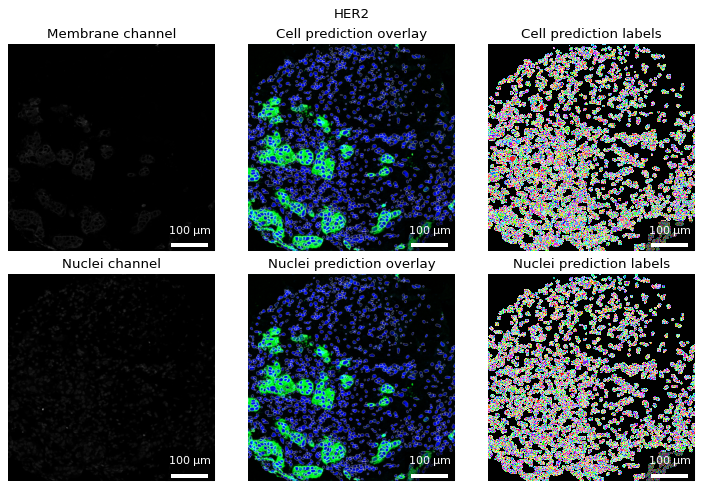

matched_cell_mask 1451
matched_nuclei_mask 1451
matched_non_nuclei_mask 1451


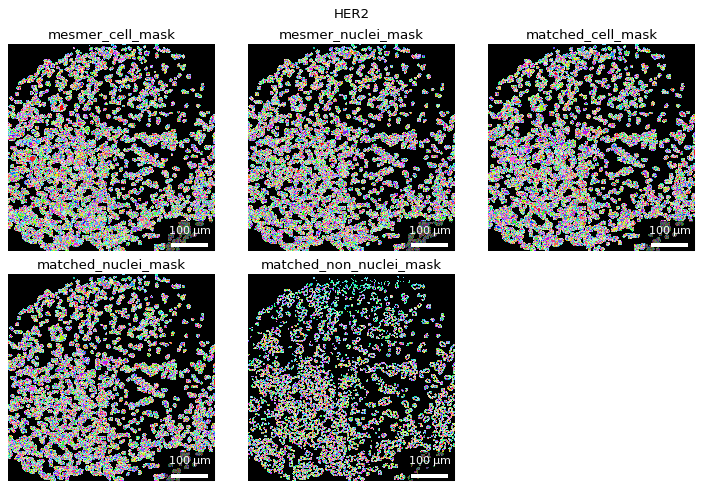

pixel size:  0.5


C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,
C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


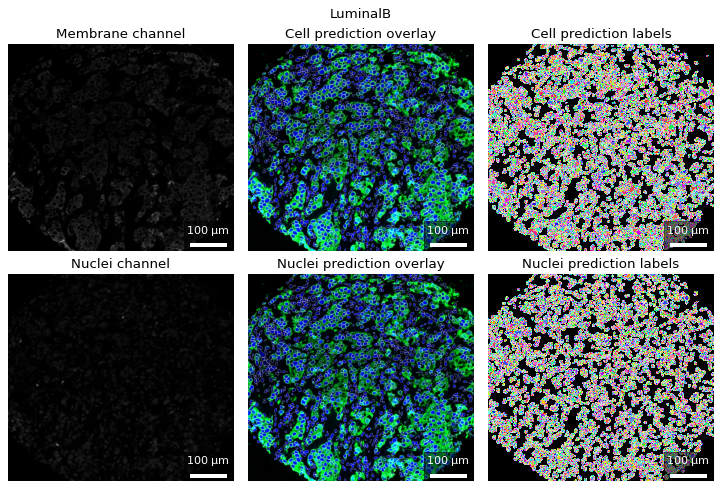

matched_cell_mask 1780
matched_nuclei_mask 1780
matched_non_nuclei_mask 1780


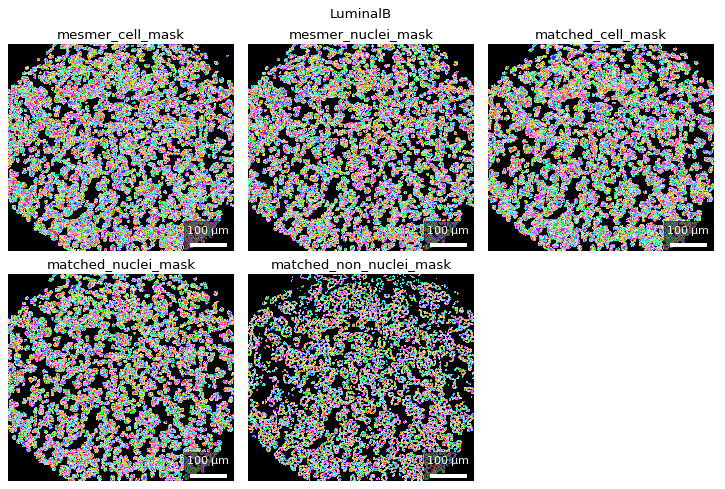

pixel size:  0.5


C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,
C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,


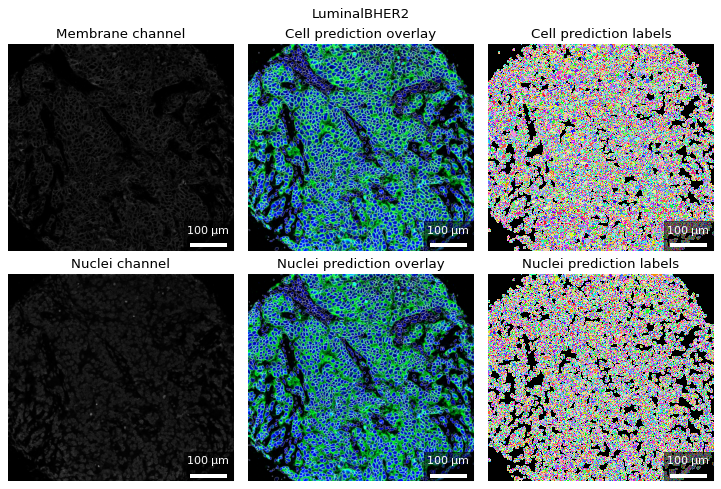

matched_cell_mask 2744
matched_nuclei_mask 2744
matched_non_nuclei_mask 2744


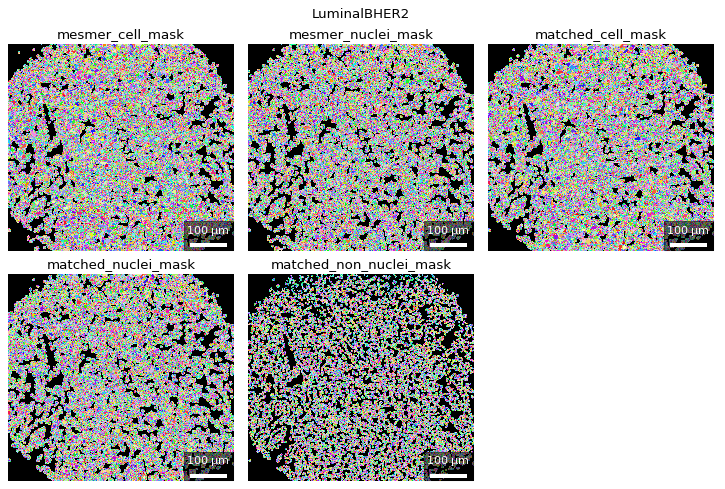

In [5]:
# Make output directory segmented images
out_sub_dir = out_dir / 'segmented'
out_sub_dir.mkdir(parents=True, exist_ok=True)
print('\n Segmented hdf files will be output to: \n\t',out_sub_dir) 

hdfs_to_segment = list(out_dir.glob('*.h5'))
hdfs_to_segment = [hdf_to_segment for hdf_to_segment in hdfs_to_segment if 'MCF7' not in hdf_to_segment.stem]

for hdf_fpath in hdfs_to_segment[:]:    
    hdf_segment = hph.hdf_to_HighPlex_Hdf(hdf_fpath=hdf_fpath)
    
    # Run segmentation
    # Parameters explained here https://github.com/vanvalenlab/deepcell-tf/blob/master/notebooks/applications/Mesmer-Application.ipynb
    hdf_segment.mesmer_segment()
    hdf_segment.mesmer_output_plot(out_dir = out_sub_dir)
    hdf_segment.cell_nuclei_match()
    hdf_segment.segmented_masks_plot(out_dir = out_sub_dir)
    hdf_segment.export_masks_to_source_hdf()
    
for source_fpath in hdfs_to_segment:
    output_fpath = out_sub_dir / f'{source_fpath.stem}_segmented.h5'
    source = copyfile(source_fpath, output_fpath)         

# hdf_segment.images['raw'].shape
# hdf_segment.channel_metadata

## Single cell analysis measurements of IMC data
Measure intensities for all cell masks

In [5]:
hdfs_to_segment = list(out_dir.glob('*.h5'))
hdfs_to_segment = [hdf_to_segment for hdf_to_segment in hdfs_to_segment if 'MCF7' not in hdf_to_segment.stem]

hdf_analysis_filepaths = [hdf_analysis_path for hdf_analysis_path in hdfs_to_segment if 'MCF7' not in hdf_analysis_path.stem]
# The order determines how loaded into hdf, and order of later output images
hdf_analysis_filepaths = [
    pathlib.Path(r'C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/HER2.h5'),
    pathlib.Path(r'C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/LuminalB.h5'),
    pathlib.Path(r'C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/LuminalBHER2.h5'),]


for hdf_path in hdf_analysis_filepaths:
    print(hdf_path.exists())

True
True
True


In [6]:
# All cell mask
image_n = 'raw'
mask_n = 'mesmer_cell_mask'
adata = hph.multiple_hph_to_adata(
    hdf_filepaths = hdf_analysis_filepaths, 
    image_n = image_n,
    mask_n = mask_n
)
# Correct variable names
isotopes = [i[0] for i in adata.var.index.str.split(' ', expand=True)]
adata.var['ab_tag'] = isotopes
adata.var['ab_tag'] = adata.var['ab_tag'].astype(str)
adata.var['longname'] = adata.var.index
adata.var = adata.var.merge(df_panel, on='ab_tag', how='left')
adata.write(out_dir.joinpath(f'IMCofGeCMOS_TMA_adata_{mask_n}.h5ad'))
# Matched cell mask
image_n = 'raw'
mask_n = 'matched_cell_mask'
adata = hph.multiple_hph_to_adata(
    hdf_filepaths = hdf_analysis_filepaths, 
    image_n = image_n,
    mask_n = mask_n
)
# Correct variable names
isotopes = [i[0] for i in adata.var.index.str.split(' ', expand=True)]
adata.var['ab_tag'] = isotopes
adata.var['ab_tag'] = adata.var['ab_tag'].astype(str)
adata.var['longname'] = adata.var.index
adata.var = adata.var.merge(df_panel, on='ab_tag', how='left')
adata.write(out_dir.joinpath(f'IMCofGeCMOS_TMA_adata_{mask_n}.h5ad'))


# Matched nuclear mask
mask_n = 'matched_nuclei_mask'
adata = hph.multiple_hph_to_adata(
    hdf_filepaths = hdf_analysis_filepaths, 
    image_n = image_n,
    mask_n = mask_n
)
# Correct variable names
isotopes = [i[0] for i in adata.var.index.str.split(' ', expand=True)]
adata.var['ab_tag'] = isotopes
adata.var['ab_tag'] = adata.var['ab_tag'].astype(str)
adata.var['longname'] = adata.var.index
adata.var = adata.var.merge(df_panel, on='ab_tag', how='left')
adata.write(out_dir.joinpath(f'IMCofGeCMOS_TMA_adata_{mask_n}.h5ad'))


# Non-nuclear mask
mask_n = 'matched_non_nuclei_mask'
adata = hph.multiple_hph_to_adata(
    hdf_filepaths = hdf_analysis_filepaths, 
    image_n = image_n,
    mask_n = mask_n
)
# Correct variable names
isotopes = [i[0] for i in adata.var.index.str.split(' ', expand=True)]
adata.var['ab_tag'] = isotopes
adata.var['ab_tag'] = adata.var['ab_tag'].astype(str)
adata.var['longname'] = adata.var.index
adata.var = adata.var.merge(df_panel, on='ab_tag', how='left')
adata.write(out_dir.joinpath(f'IMCofGeCMOS_TMA_adata_{mask_n}.h5ad'))


AnnData expects .var.index to contain strings, but your first indices are: Int64Index([0, 1], dtype='int64'), …
... storing 'label_id' as categorical
... storing 'sample_name_ref' as categorical
... storing 'AB_panel' as categorical
... storing 'hph_mask_key' as categorical
... storing 'hph_image_key' as categorical
... storing 'hph_id' as categorical
... storing 'shortname_x' as categorical
... storing 'xrf_emission' as categorical
... storing 'target' as categorical
... storing 'shortname_y' as categorical
... storing 'ab_clone' as categorical
AnnData expects .var.index to contain strings, but your first indices are: Int64Index([0, 1], dtype='int64'), …
... storing 'label_id' as categorical
... storing 'sample_name_ref' as categorical
... storing 'AB_panel' as categorical
... storing 'hph_mask_key' as categorical
... storing 'hph_image_key' as categorical
... storing 'hph_id' as categorical
... storing 'shortname_x' as categorical
... storing 'xrf_emission' as categorical
... storing

## Single cell analysis

### Cell type clustering

In [7]:
# adata = ad.read_h5ad(out_dir.joinpath('IMCofSDD_cell_pellets_adata_mesmer_cell_mask.h5ad'))
adata = ad.read_h5ad(out_dir.joinpath('IMCofGeCMOS_TMA_adata_matched_cell_mask.h5ad'))
adata.var.set_index('xrf_emission', inplace=True)

# adata.X = np.arcsinh(adata.X/5)
# adata.X = np.arcsinh(adata.X/1)

adata.X = np.log(adata.X)
adata.X[np.isinf(adata.X)] = 0

cluster_channels = [
    'Ce_Ka', 
    'Dy_Ka', 
    'Er_Ka', 
    'Eu_Ka', 
    'Gd_Ka', 
    #'Ho_Ka', 
    #'Ir_L3', 
    'La_Ka',
    'Lu_Ka',
    #'Nd_Ka',
    #'Pr_Ka',
    #'Rh_Ka',
    'Sm_Ka',
    'Tb_Ka',
    'Tm_Ka'
]

cluster_channel_var = []
for i in adata.var.index: 
    cluster_channel_var.append(i in cluster_channels)
adata.var['cluster_channels'] = cluster_channel_var
adata.var['cluster_channels'] = adata.var['cluster_channels'].astype('category')

C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\pandas\core\arrays\categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


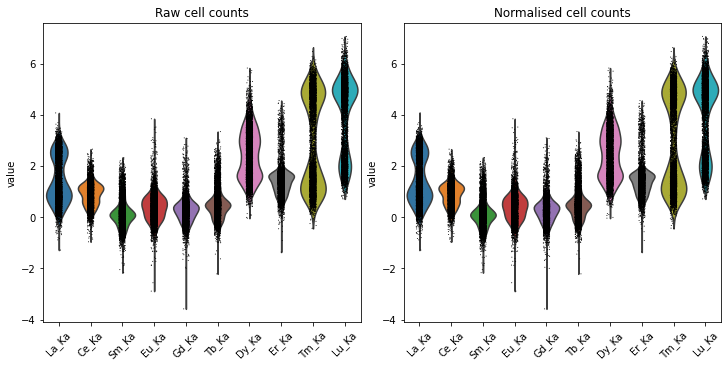

In [8]:
adata = adata[:, adata.var['cluster_channels']==True]
# adata.raw.var_names_make_unique()

# normalised_data = adata.X.copy()
# normalised_data = hph_adata.column_percentile_normalise_test(
#     normalised_data, 
#     2, 
#     98, 
#     crop=False
# )
# adata.X = normalised_data

fig, axs = plt.subplots(1, 2, figsize=(10,5), constrained_layout=True)
set_xticklabels = {'labels': list(adata.var_names), 'rotation':45}
g1 = sc.pl.violin(
    adata, 
    adata.var_names, 
    ax=axs[0], 
    show=False, 
#     use_raw=True,
    **set_xticklabels
    #set_xticklabels=set_xticklabels
)
g2 = sc.pl.violin(
    adata, 
    adata.var_names, 
    ax=axs[1], 
    show=False, 
#     use_raw=False,
    **set_xticklabels
    #set_xticklabels=set_xticklabels
)

axs[0].title.set_text('Raw cell counts')
axs[1].title.set_text('Normalised cell counts')                      

plt.show()

C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


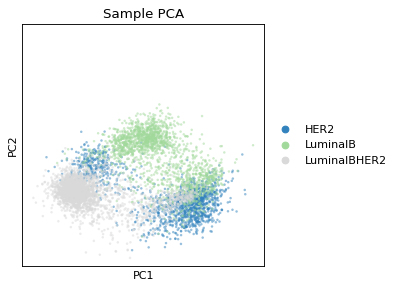

In [9]:
# Principal component analyses
sc.tl.pca(adata, svd_solver='arpack')

# Plot out principal components
fig, axs = plt.subplots(figsize=(4,4), dpi=80)
sc.pl.pca(
    adata, 
    color='sample_name_ref', 
    palette = 'tab20c',
    ax=axs, 
    title='Sample PCA', 
    show=False,
    **{'alpha':0.5}
)
plt.axis('square')
plt.show()

In [10]:
adata

AnnData object with n_obs × n_vars = 5972 × 10
    obs: 'centroid-0', 'centroid-1', 'orientation', 'major_axis_length', 'minor_axis_length', 'area', 'eccentricity', 'perimeter', 'label_id', 'sample_name_ref', 'step_um', 'AB_panel', 'hph_mask_key', 'hph_image_key', 'hph_id'
    var: 'shortname_x', 'longname', 'ab_tag', 'tag_isotope', 'target', 'saber_rounds', 'shortname_y', 'ab_clone', 'stock_conc_ug_per_ml', 'use_conc_ug_per_mL', 'nuclear_segment', 'cell_segment', 'cluster_channels'
    uns: 'high_plex_hdf_paths', 'pca', 'sample_name_ref_colors'
    obsm: 'X_pca'
    varm: 'PCs'

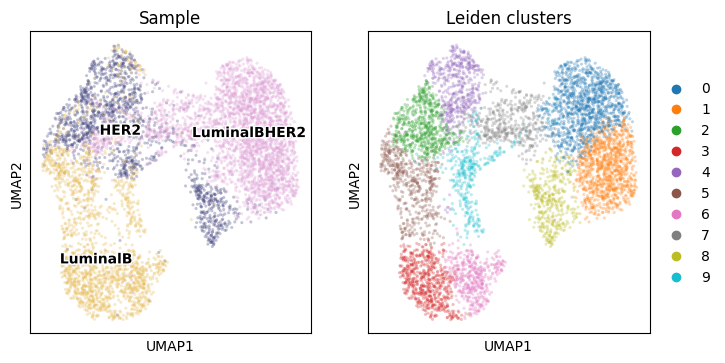

In [11]:
sc.pp.neighbors(adata, n_neighbors=30)
sc.tl.umap(adata, random_state=5)
sc.tl.leiden(adata, resolution=0.7)

fig, axs = plt.subplots(1, 2, figsize=(8,4), dpi=100)#, constrained_layout=True)
sc.pl.umap(
    adata, 
    color='sample_name_ref',
    palette = 'tab20b',
    ax=axs.flatten()[0], 
    frameon=True, 
    show=False,
    legend_loc='on data',
    legend_fontoutline=2,
    title = 'Sample',
    **{'alpha':0.3}
    )
sc.pl.umap(
    adata, 
    color='leiden', 
    ax=axs.flatten()[1], 
    frameon=True, 
    show=False,
    title = 'Leiden clusters',
    **{'alpha':0.3}
    )
plt.show()




C:\Users\MerrickS\Anaconda3\envs\mez-xrf\lib\site-packages\scanpy\tools\_rank_genes_groups.py:419: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


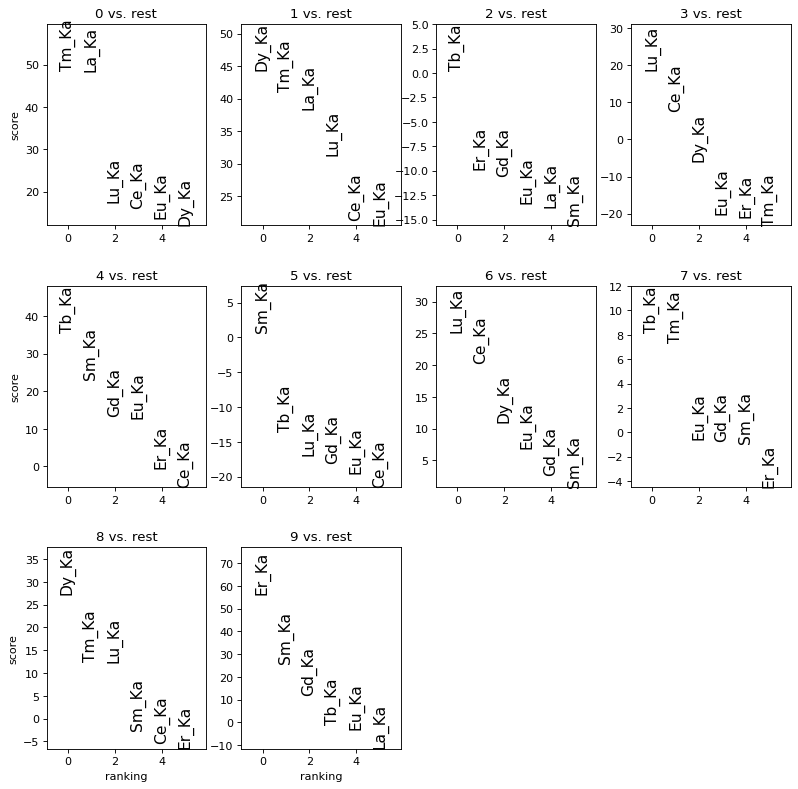

In [12]:
sc.tl.rank_genes_groups(adata, 
                        groupby='leiden', 
                        use_raw=False, 
                        method='t-test_overestim_var', 
                        # method='t-test', 
                        n_genes=6
                        ) # compute differential expression


with rc_context({'figure.figsize': (3, 4), 'figure.dpi': 80}):
    sc.pl.rank_genes_groups(
        adata, 
        groupby='leiden', 
        n_genes=6, 
        ncols=4, 
        sharey=False, 
        fontsize=14
    )

In [13]:
cluster2annotation = {
    '0': 'PR$^{+}$ epithelia',
    '1': 'HER2$^{+}$ PR$^{+}$ epithelia',
    '2': 'Stromal cells',
    '3': 'ER$^{+}$ epithelia',
        '4': 'Exhausted CD4 T-cells',
        '5': 'T-cells',
        '6': 'Epithelial cells',
        '7': 'HER2$^{+}$ epithelia',
        '8': 'CK7$^{+}$  epithelia',
        '9': 'PD1$^{+}$  helper T-cells',
}

## Cluster annotations as per XRF
# cluster2annotation = {
#     '0': 'Stromal cells',
#     '1': 'HER2$^{+}$ PR$^{+}$ epithelia',
#     '2': 'PR$^{+}$ epithelia',
#     '3': 'ER$^{+}$ epithelia',
#     '4': 'T-cells',
#     '5': 'HER2$^{+}$ epithelia',
#     '6': 'Epithelial cells',
#     '7': 'Exhausted CD4 T-cells',
#     '8': 'CK7$^{+}$  epithelia',
#     '9': 'PD1$^{+}$  helper T-cells',
# }

imc_xrf_colormap = {
    0:2,
    1:1,
    2:0,
    3:3,
    4:7,
    5:4,
    6:6,
    7:5,
    8:8,
    9:9,
}

adjusted_colors = []
for i in range(len(cluster2annotation)):
    adjusted_colors.append(adata.uns['leiden_colors'][imc_xrf_colormap[i]])

# # Annotate adata with leiden cell type cluster names
adata.obs['leiden_cluster_names'] = adata.obs['leiden'].map(cluster2annotation).astype('category')
adata.uns['leiden_colors'] = adjusted_colors #  adata.uns['leiden_colors']
adata.uns['leiden_cluster_names_colors'] = adata.uns['leiden_colors']



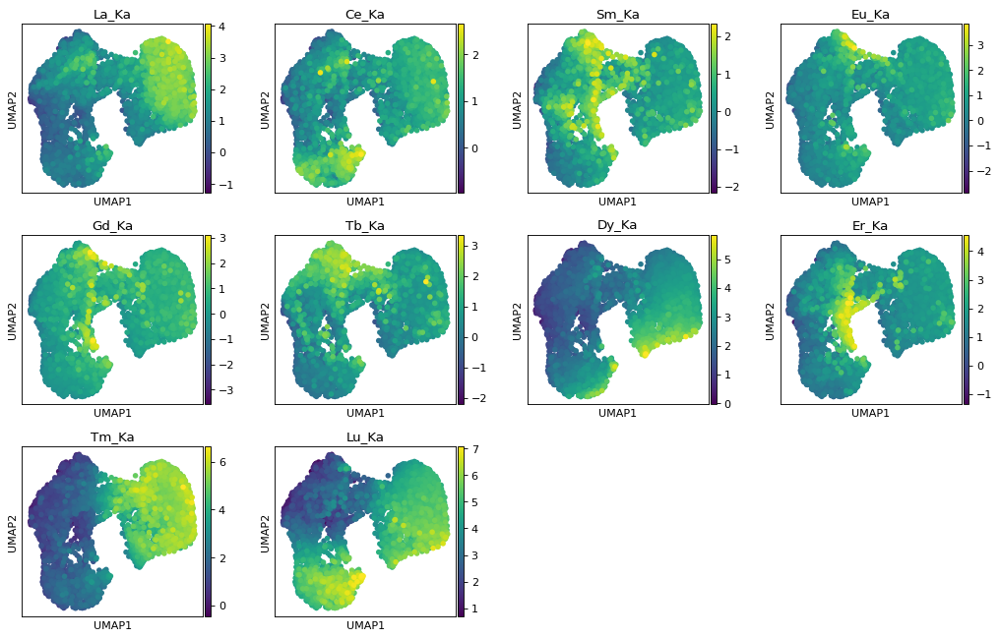

In [14]:
with rc_context({'figure.figsize': (3, 3), 'figure.dpi': 80}):
    sc.pl.umap(
        adata, 
        color=adata.var_names, 
        ncols=4, 
        # frameon=False, 
        show=False, 
        use_raw=False, 
        size=100,
        # legend='off'
    )
plt.show()

In [15]:
samples_path = ['HER2$^{+}$', 'LumB', 'LumB HER2$^{+}$']
samples_path_dict_overview = dict(
    zip(
        list(['HER2', 'LuminalB', 'LuminalBHER2']),
        samples_path
    )
)
adata.obs['sample_pathology_names'] = adata.obs['sample_name_ref'].map(samples_path_dict_overview)

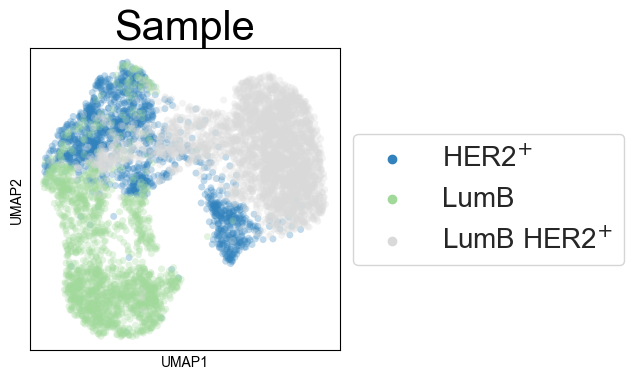

In [16]:
fig, axs = plt.subplots(figsize=(4,4), dpi=100)#, constrained_layout=True)
sns.set(font_scale=2.5)

g1 = sc.pl.umap(
    adata, 
    color='sample_pathology_names',
    palette = 'tab20c',
    ax=axs, 
    frameon=True, 
    show=False,
    #legend_loc='on data',
    gene_symbols={"HER2":"1","LuminalB":"2", "LuminalBHER2":"3"},
    legend_fontoutline=2,
    title = 'Sample',
    size=100,
    **{'alpha':0.3}
    )


axs.set_facecolor('white')
axs.legend(loc='center left', bbox_to_anchor=(1, 0.5), facecolor='white', prop={'size': 20})

plt.show()


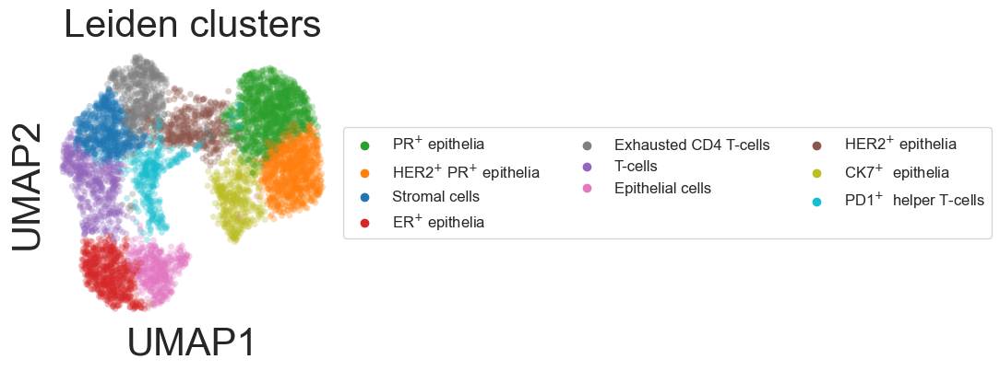

In [17]:
fig, axs = plt.subplots(figsize=(4,4), dpi=100)#, constrained_layout=True)
sns.set(font_scale=2.5)

g1 = sc.pl.umap(
    adata, 
    color='leiden_cluster_names',
    ax=axs, 
    frameon=True, 
    show=False,
    #legend_loc='on data',
    gene_symbols={"HER2":"1","LuminalB":"2", "LuminalBHER2":"3"},
    legend_fontoutline=2,
    title = 'Leiden clusters',
    size=100,
    **{'alpha':0.3}
    )

axs.set_facecolor('white')
axs.legend(ncol=3, loc='center left', bbox_to_anchor=(1, 0.5), facecolor='white', prop={'size': 12})

plt.show()

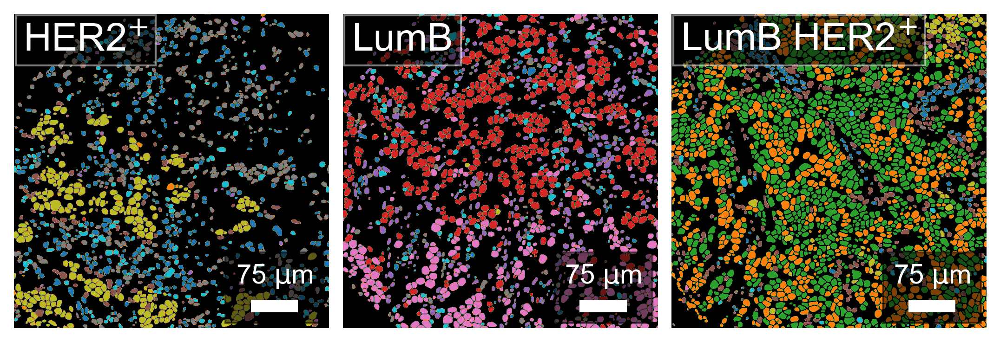

In [18]:
from importlib import reload  # Python 3.4+
reload(hph_adata)

hph_adata.adata_hph_mask_cluster_plot(
    adata=adata,
    cluster_name='leiden',
    plot_names = samples_path,
    crop_dims = [0,1000,0,1000]
)


In [19]:
from skimage.transform import rescale, resize, downscale_local_mean


def multi_hph_plot(hph_fpath_dict, hph_list, img_lib, channels, pxl, scale, color_bar_label, plot_name_split=None):
    """
    Function to plot multiple hph_paths
    
    :param hph_fpath_dict: dicitonary of hph filenames and filepaths
    :param hph_list: ordered list of hph files to plot from hph dict
    :param img_lib: image node from hph['images'] of hph files to plot
    :param channels: ordered list of channels to plot
    """
    
    fig = plt.figure(
        figsize=(3*len(hph_list), 3*len(channels)), 
        dpi=300
    )

    grid = ImageGrid(
        fig, 111,          # as in plt.subplot(111)
        nrows_ncols=(len(channels), len(hph_list)),
        axes_pad=0.1,
        share_all=True,
        cbar_mode="edge",
        cbar_location="right",
        cbar_size="5%",
        cbar_pad=0.1,
    )

    grid_counter = 0
    for row, channel in enumerate(channels):

        img_max = dict.fromkeys(hph_list)
        img_min = dict.fromkeys(hph_list)

        # Get min max values for row
        for hph_roi in hph_list:
            hph_hdf = hph.hdf_to_HighPlex_Hdf(hph_fpath_dict[hph_roi])

            plot_channels = hph_hdf.channel_metadata[
                (hph_hdf.channel_metadata['shortname'] != 'nan') &
                (hph_hdf.channel_metadata['xrf_emission'].isin(channels))    
            ]

            idx = plot_channels[plot_channels['xrf_emission'] == channel].index
            img = hph_hdf.images[img_lib][:,:,idx]

            low_p, high_p = np.percentile(img, [0.5,98])
            img_min[hph_roi] = low_p
            img_max[hph_roi] = high_p

        vmin=min(img_min.values())
        vmax=max(img_max.values())

        # Set colorbar for row
        cax = grid.cbar_axes[row]        
        cbar = plt.colorbar(
            plt.cm.ScalarMappable(
                norm=plt.Normalize(
                    vmin=vmin, 
                    vmax=vmax,
                ), 
                cmap='gray'
            ), 
            cax=cax,
        )
        
        # Pad tick labels for consistent width
        tick_labels = cbar.ax.get_yticks()      
        tick_labels_padded = ['{0: <4}'.format(int(lbl)) for lbl in tick_labels]
        cbar.ax.set_yticklabels(tick_labels_padded)  # vertically oriented colorbar
        
        cbar.set_label(
            color_bar_label, 
            rotation=270,
            labelpad=15,
            fontsize = 14
        )

        # Plot channel per sample
        for hph_roi in hph_list:
            img_dims_dict = {
                'HER2':[0,0],
                'LuminalB':[0,0],
                'LuminalBHER2':[0,0],
            }
            img_dims = img_dims_dict[hph_roi]
            
            
            hph_hdf = hph.hdf_to_HighPlex_Hdf(hph_fpath_dict[hph_roi])
            img = hph_hdf.images[img_lib][:,:,idx]
            
            # If element represented in multiple channels, take the first
            if img.shape[-1] == 2:
                img = img[:,:,0]

            img = filters.gaussian(img, sigma=0.8)
#             img = np.rot90(img)
            img = img[img_dims[0]:img_dims[0]+1000,img_dims[1]:img_dims[1]+1000]

            grid[grid_counter].imshow(
                img,
                vmin=vmin,
                vmax=vmax,
                cmap = 'gray'
            )

            grid[grid_counter].axis('off')
            
            top_left_text = plot_channels['longname_imc'][plot_channels['xrf_emission'] == channel].iloc[0]
            
            if isinstance(plot_name_split, str):
                if plot_name_split in top_left_text:
                    split_text = top_left_text.split(plot_name_split)
                    top_left_text = split_text[0]
                    
                    if len(split_text) < 2:
                        bottom_left_text = ' '
                    else:
                        bottom_left_text = split_text[1]
                    grid[grid_counter].text(
                        0.03, 0.03, 
                        s = f"({bottom_left_text}",
                        horizontalalignment='left', 
                        verticalalignment='bottom', 
                        transform=grid[grid_counter].transAxes,
                        fontsize=14,
                        color='white',
                        bbox=dict(facecolor='black', alpha=0.5)
                    )

            grid[grid_counter].text(
                0.03, 0.97, 
                s = top_left_text,
                horizontalalignment='left', 
                verticalalignment='top', 
                transform=grid[grid_counter].transAxes,
                fontsize=14,
                color='white',
                bbox=dict(facecolor='black', alpha=0.5)
                )

#             grid[grid_counter].text(
#                 0.03, 0.97, 
#                 s = plot_channels['longname_imc'][
#                     plot_channels['xrf_emission'] == channel
#                 ].iloc[0],
#                 horizontalalignment='left', 
#                 verticalalignment='top', 
#                 transform=grid[grid_counter].transAxes,
#                 fontsize=18,
#                 color='white',
#                 bbox=dict(facecolor='black', alpha=0.5)
#             )

            scalebar = ScaleBar(
                        pxl,
                        "um", 
                        fixed_value=scale,
                        location='lower right',
                        width_fraction=0.04,
                        color='white',
                        scale_loc='top',
                        box_alpha=0.5,
                        box_color='black',
                        font_properties={'size':14},
                    )
            grid[grid_counter].add_artist(scalebar)

            grid_counter =  grid_counter+1


In [20]:
hdf_analysis_filepaths

[WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/HER2.h5'),
 WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/LuminalB.h5'),
 WindowsPath('C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/analysis/imc/8e_imc_TMA/LuminalBHER2.h5')]

<ipython-input-19-83e42b639f15>:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(tick_labels_padded)  # vertically oriented colorbar


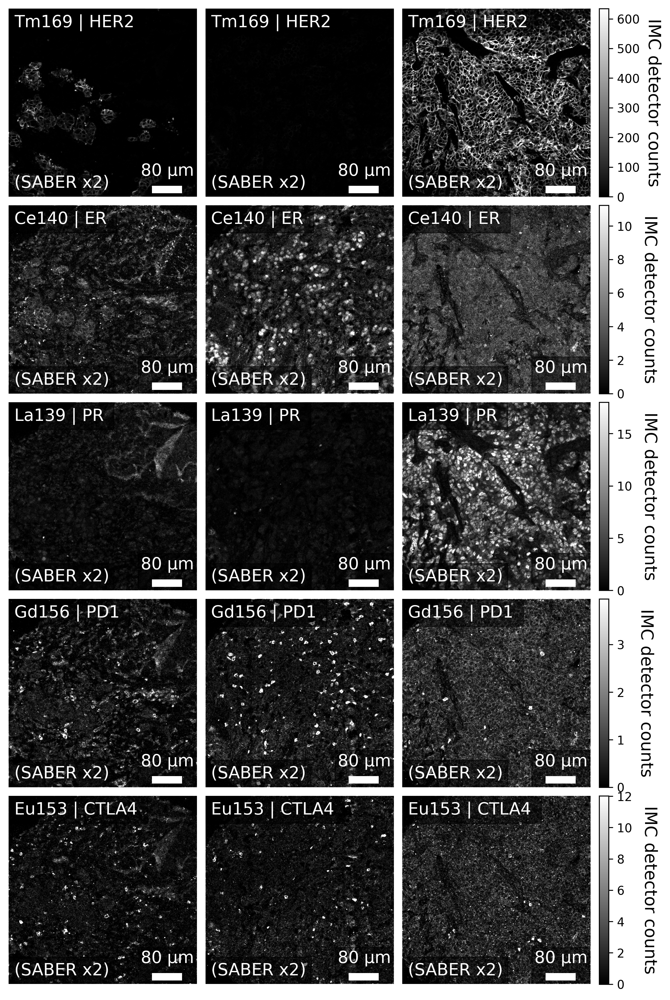

In [21]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

hph_list = ['HER2', 'LuminalB', 'LuminalBHER2']
hdf_dict = dict(zip(hph_list, hdf_analysis_filepaths))

fig_channels_1= [
    'Tm_Ka',
    'Ce_Ka',
    'La_Ka',
    'Gd_Ka',
    'Eu_Ka',
]

multi_hph_plot(
    hph_fpath_dict = hdf_dict, 
    hph_list = hph_list, 
    img_lib = 'raw', 
    channels = fig_channels_1,
    pxl=0.5,
    scale=80,
    color_bar_label = 'IMC detector counts',
    plot_name_split='('
)


<ipython-input-19-83e42b639f15>:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(tick_labels_padded)  # vertically oriented colorbar


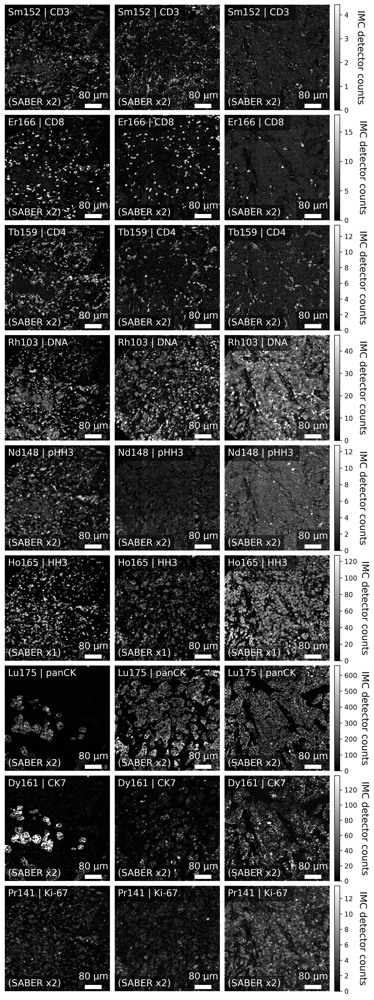

In [22]:
fig_channels_sup = [
    'Sm_Ka',
    'Er_Ka', 
    'Tb_Ka', 
    'Rh_Ka',
    'Nd_Ka',
    'Ho_Ka',
    'Lu_Ka',
    'Dy_Ka',
    'Pr_Ka'
]  

multi_hph_plot(
    hph_fpath_dict = hdf_dict, 
    hph_list = hph_list, 
    img_lib = 'raw', 
    channels = fig_channels_sup,
    pxl=0.5,
    scale=80,
    color_bar_label = 'IMC detector counts',
    plot_name_split='('
)


## Signal to noise comparison

In [7]:
adata2.obs['Hz'] = 200
adata2.X = np.exp(adata2.X) # we are going to compare raw signal between instruments

df_to_map = adata2.var
df_to_map['longname'] = df_to_map.index
df_to_map['Symbol'] = df_to_map['xrf_emission'].str.split('_', expand=True).iloc[:,0]
df_to_map = pd.merge(df_to_map, df_periodic_table[['AtomicNumber', 'Element', 'Symbol']], on='Symbol')
df_to_map

NameError: name 'adata2' is not defined

In [ ]:
df_signal_to_noise = pd.DataFrame()
for hz in adata2.obs['Hz'].unique():
    row = {}
    row['Hz'] = hz
    adata_Hz = adata2[adata2.obs['Hz'] == hz]
    for var_name in adata_Hz.var_names:
        row['var_name'] = var_name

        var_values = adata_Hz[:,var_name].X

        # Sample the max and mean signal in top and bottom (specified) % of cells
        non_zero_values = sorted(var_values[np.nonzero(var_values)])
        percentage = 1
        cell_sample = int(len(non_zero_values) / 100) * percentage
        row['minval'] = np.mean(non_zero_values[:cell_sample])
        row['maxval'] = np.max(non_zero_values[-cell_sample:])

        # Add rows to dataframe
        if df_signal_to_noise.empty:
            df_signal_to_noise = pd.DataFrame(columns=row.keys())            
        df_signal_to_noise = df_signal_to_noise.append(row, ignore_index=True)
            
# # Sort data types
df_signal_to_noise['var_name'] = df_signal_to_noise['var_name'].astype('category')
df_signal_to_noise['Hz'] = df_signal_to_noise['Hz'].astype('category')
df_signal_to_noise['minval'] = df_signal_to_noise['minval'].astype('float')
df_signal_to_noise['maxval'] = df_signal_to_noise['maxval'].astype('float')
df_signal_to_noise['signal-to-noise'] = (df_signal_to_noise['maxval'] - (df_signal_to_noise['minval']))
 
df_signal_to_noise[['ab_tag', 'shortname']] = df_signal_to_noise['var_name'].str.split(' ', expand=True).iloc[:,[0,2]].rename(columns={0:'ab_tag', 1:'shortname'})
df_signal_to_noise = pd.merge(df_signal_to_noise, df_to_map, left_on='ab_tag', right_on='ab_tag', suffixes=('', '_y'))
df_signal_to_noise.drop(df_signal_to_noise.filter(regex='_y$').columns, axis=1, inplace=True)
df_signal_to_noise['Method'] = 'IMC'
df_signal_to_noise


In [ ]:
# Set seaborn
from matplotlib.ticker import ScalarFormatter
import matplotlib.ticker as ticker

sns.set_style("dark")

### Check max and min values
fig, axs = plt.subplots(ncols = 2, figsize=(10,5), dpi=300)

g = sns.stripplot(
    data = df_signal_to_noise,
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'minval',
    ax=axs[0],
    hue='Hz'
)
axs[0].tick_params(axis='x', rotation=90)

# Set scale
g.set(yscale="log")
#Set gridlines
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')

g = sns.stripplot(
    data = df_signal_to_noise,
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'maxval',
    ax=axs[1],
    hue='Hz',
)
axs[1].tick_params(axis='x', rotation=90)


# Set scale
g.set(yscale="log")
#Set gridlines
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')

# Sort shared legend
# axs[0].get_legend().remove()
# axs[1].get_legend().remove()
# plt.legend(title='Raster rate (Hz)', bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)
plt.xticks(rotation=90)#, ha='right')
plt.show()

### Plot signal to noise
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
g = sns.stripplot(
    data = df_signal_to_noise,
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'signal-to-noise',
    ax=ax,
    hue='Hz'
)
ax.set(yscale="log")
ax.set_ylim([0.1, 10000])
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:g}'.format(y)))
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')
plt.xticks(rotation=90)#, ha='right')
plt.ylabel('Signal-to-noise')
plt.xlabel(' ')
# plt.legend(title='Raster rate (Hz)', bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)
plt.show()

## IMC and XRF signal to noise

In [ ]:
adata_xrf_path = pathlib.Path(r'C:/Users/MerrickS/OneDrive/Work/2_UZH/Papers/1_MEZ_XRF/data/processed/xrf/5b_cell_pellet_quantification/cell_pellets_adata_matched_cell_analysed_signal_to_noise.h5ad')
adata_xrf_path.exists()

adata_xrf = ad.read_h5ad(adata_xrf_path)
adata_xrf.obs['Hz'] = 1
adata_xrf.var


In [ ]:
df_xrf_signal_to_noise = pd.DataFrame()
for hz in adata_xrf.obs['Hz'].unique():
    row = {}
    row['Hz'] = hz
    adata_Hz = adata_xrf[adata_xrf.obs['Hz'] == hz]
    for var_name in adata_Hz.var_names:
        row['var_name'] = var_name

        var_values = adata_Hz[:,var_name].X

        # Sample the max and mean signal in top and bottom (specified) % of cells
        non_zero_values = sorted(var_values[np.nonzero(var_values)])
        percentage = 1
        cell_sample = int(len(non_zero_values) / 100) * percentage
        row['minval'] = np.mean(non_zero_values[:cell_sample])
        row['maxval'] = np.max(non_zero_values[-cell_sample:])

        # Add rows to dataframe
        if df_xrf_signal_to_noise.empty:
            df_xrf_signal_to_noise = pd.DataFrame(columns=row.keys())            
        df_xrf_signal_to_noise = df_xrf_signal_to_noise.append(row, ignore_index=True)
            
# # Sort data types
df_xrf_signal_to_noise['var_name'] = df_xrf_signal_to_noise['var_name'].astype('category')
df_xrf_signal_to_noise['Hz'] = df_xrf_signal_to_noise['Hz'].astype('category')
df_xrf_signal_to_noise['minval'] = df_xrf_signal_to_noise['minval'].astype('float')
df_xrf_signal_to_noise['maxval'] = df_xrf_signal_to_noise['maxval'].astype('float')
df_xrf_signal_to_noise['signal-to-noise'] = (df_xrf_signal_to_noise['maxval'] - (df_xrf_signal_to_noise['minval']))
 
df_xrf_signal_to_noise['xrf_emission'] = df_xrf_signal_to_noise['var_name'].str.split(' ', expand=True).iloc[:,0]
# df_xrf_signal_to_noise[['ab_tag', 'shortname']] = df_xrf_signal_to_noise['var_name'].str.split(' ', expand=True).iloc[:,[0,2]].rename(columns={0:'ab_tag', 1:'shortname'})
df_xrf_signal_to_noise = pd.merge(df_xrf_signal_to_noise, df_to_map, left_on='xrf_emission', right_on='xrf_emission', suffixes=('', '_y'))
df_xrf_signal_to_noise.drop(df_xrf_signal_to_noise.filter(regex='_y$').columns, axis=1, inplace=True)
df_xrf_signal_to_noise['Method'] = 'XRF(SDD)'
df_xrf_signal_to_noise

In [ ]:
df_collated_signal_to_noise = df_signal_to_noise[['Hz', 'minval', 'maxval', 'signal-to-noise', 'ab_tag', 'Symbol', 'longname', 'AtomicNumber', 'Element', 'Method']]
df_collated_signal_to_noise = df_collated_signal_to_noise.append(df_xrf_signal_to_noise[df_collated_signal_to_noise.columns], ignore_index=True)
df_collated_signal_to_noise

In [ ]:
import matplotlib.lines as mlines
import matplotlib.pyplot as plt

# Set seaborn
from matplotlib.ticker import ScalarFormatter
import matplotlib.ticker as ticker

sns.set_style("dark")

### Check max and min values
fig, axs = plt.subplots(ncols = 2, figsize=(10,5), dpi=300)

g = sns.stripplot(
    data = df_collated_signal_to_noise,
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'minval',
    ax=axs[0],
    hue='Method'
)
axs[0].tick_params(axis='x', rotation=90)

# Set scale
g.set(yscale="log")
#Set gridlines
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')

g = sns.stripplot(
    data = df_collated_signal_to_noise,
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'maxval',
    ax=axs[1],
    hue='Method'
)
axs[1].tick_params(axis='x', rotation=90)


# Set scale
g.set(yscale="log")
#Set gridlines
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')

# Sort shared legend
# axs[0].get_legend().remove()
# axs[1].get_legend().remove()
# plt.legend(title='Raster rate (Hz)', bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)
plt.xticks(rotation=90)#, ha='right')
plt.show()

### Plot signal to noise
fig, ax = plt.subplots(figsize=(7,2), dpi=300)
g = sns.stripplot(
    data = df_collated_signal_to_noise[df_collated_signal_to_noise['Method'] == 'XRF(SDD)'],
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'signal-to-noise',
    ax=ax,
#     hue='Method',    
    color = 'black'
)

g = sns.stripplot(
    data = df_collated_signal_to_noise[df_collated_signal_to_noise['Method'] == 'IMC'],
    x = 'longname',
    order = df_to_map.sort_values('AtomicNumber')['longname'].to_list(),
    y = 'signal-to-noise',
    ax=ax,
    hue='Method',  
    palette = ['red'],
    marker='^',
)

ax.set(yscale="log")
ax.set_ylim([1, 1000])
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda y, _: '{:g}'.format(y)))
g.grid(which='major', c='w', lw=3, axis='y')
g.grid(which='major', c='w', lw=2, axis='x')
g.grid(which='minor', c='w', lw=1, axis='y')
g.grid(which='minor', c='w', lw=1, axis='x')
plt.xticks(rotation=90)#, ha='right')
plt.ylabel('Signal-to-noise')
plt.xlabel(' ')


# # Custom set the marker for IMC
handles, labels = ax.get_legend_handles_labels()
black_spot = mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=4, label='Black spot')
red_triangle = mlines.Line2D([], [], color='red', marker='^', linestyle='None', markersize=4, label='Red triangles')

handles[0] = black_spot
handles.append(red_triangle)


lgd = plt.legend(
    title='Detector',
    loc='upper left', bbox_to_anchor=(1.05, 1.05), 
#     ncol=2,
    borderaxespad=0., 
    labels=['1 Hz MEZ-XRF (SDD)', '200 Hz IMC'],
    handles = handles,
    fontsize=8
)

# for legend_handle in lgd.legendHandles[:-1]:
#     legend_handle.set_sizes([8])


# plt.legend(title='Raster rate (Hz)', bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)
plt.show()